# Toy LM-GC Plasticity Model

## Description
This is a simplified periodic representation model where we represent:
1. several GC modules whose activity is already periodic in time (consistently with pre-existing CAN dynamics that we find in our data);
2. a single LM unit (landmark cell)
3. two inputs to LM:

    - $I_{\text{ext}}$: external landmark drive (when visual landmarks are visible - NTS task)
    - $I_{\text{int}}$: internal input from GC cells, weighted by plastic synapses

### Assumptions this model relies on:
1. No real movement, but velocity input comes from efference copy / reafference during joystick deflections

2. model units (GC units) interact with LM units (landmark neurons)

3. plastic connections between GC units and LM units

### What this model explains
**How the network can learn which GC population encodes the external landmark sequence** and later **replay endogenous landmarks without sensory input**

*(Rk)* it is not doing path integration with noise yet; it is about associating the LM with the correct GC module and phase

**Goal**: establish that $I_{\text{int}}$ can emulate $I_{\text{ext}}$.
This simple model provides a candidate circuit mechanism for the storage of external landmarks in the EC, and shows that a subset of EC units whose phase and frequency matches external structure could drive LM.

### Model for Learning
- Updates $GC \mapsto LM$ weights with a Hebbian-like rule (Oja's rule). Conceptually, LM strenghtens connections from those GC cells whose *period* and *phase* match this external drive

    - While $I_{\text{ext}}$ is *ON*, the external landmark is visible and the visual input contributes to the overall activity
    - After learning, $I_{\text{ext}}$ is turned *OFF* (MNAV), and LM should still show bumps at the correct times purely from GC inputs ($I_{\text{int}}$))

### Need to feed the model:
- $M$ EC modules
- A Landmark unit: a module whose frequency matches the external visual input + a specific phase $\phi$ in degrees indicating the exact moment in the period where the landmark recurs
- $\eta$: learning rate for Oja's weight update

## Clean Mathematical Formulation

### 1. Dimensions and Parameters
- $M$: number of EC modules

- $K = 360$: neurons per module (they do not represent actual *physical* neurons, but instead represent the number of phase bins allowing for fine sampling of the internal temporal phase and for smoother representation)

- $t \in \{1,2,...,T\}$: discrete time steps

- $\text{scale}[i]$: speed scaling factor for module $i$

- $\text{LM}_{\text{module}}$ = index $m^* \in \{1,\dots, M\}$

- $\text{LM}_{\text{phase}}$ = index $\phi^* \in \{0, \dots, K-1\}$

### 2. Construct EC Modules: bump matrices
- For each module $i$:

    1.  create a bump vector $g_i \in \mathbb{R}^K$ (Gaussian over indices $0,\dots, K-1$), where each of the $360$ entries are used as the positions on the circular attractor. So the entries in $g_i$ characterize the shape of the bump in a cycle, and it is discretized by the $360$ neurons (bins) to model the resolution of the Gaussian curve.

    2. phase shifting: sliding the bump along the neuron axis and wrap around the edges $\rightarrow$ model bump as it shifts through all $360$ phase positions.

so for each module $i$:\
we have a matrix $E_i \in \mathbb{R}^{K\times K}$ where the column vector at phase $\phi$ is $E_i[:, \phi]$ = circshift($g_i, \phi$):

$E_i = [g_i, \text{shift}(g_i, \phi=1), \text{shift}(g_i, \phi=2), \dots, \text{shift}(g_i, \phi = 359)] = [e_i(0), \dots, e_i(K-1)]$

### 3. Time evolution of phase
All modules share the same ring count of $K$ neurons. The only difference is **how fast they move through the ring**

Given external (global) time $t$:
1. Convert global time $t$ into the module's internal time $t_i$:\
$t_i = \text{round}(\frac{t}{\text{scale}[i]})$

2. Convert that internal time into a **phase index** $\phi_i(t)$ on the ring:\
$\phi_i(t) = (t_i-1) \mod K$

3. Wrap around using modulo because phase is circular

*rk)* The scale factor denotes the underlying period needed to travel one space unit (bin), so:
- larger scale $\Longrightarrow$ moves more slowly
- smaller scale $\Longrightarrow$ moves faster

#### Velocity and Scale
$\text{velocity}[i] \propto \frac{1}{\text{scale}[i]}$

### 4. EC activity in terms of time
The current EC activity for module $i$ can thus be written as a function of time:\
$x_i(t) = E_i[:, \phi_i(t)] \in \mathbb{R}^K$

And then, the matrix storing the current activity of all EC modules at time $t$ can be expressed as:\
$X(t) = [x_i(t), x_2(t), \dots, x_M(t)] \in \mathbb{R}^{K\times M}$

### 5. LM External Pattern
- They build a bump template $g_{LM} \in \mathbb{R}^K$, using the same base width param $a$ but without the module-specific scale factor

- Given the target landmark phase in degrees LM_phase, if $K\neq 360$, they convert it into a phase bin:\
$\phi^* = \frac{\text{LM\_phase} \times K}{360}$

-  The external landmark is then constructed by *circularly shifting* the base bump by $\phi^*$\
$\text{g}_{\text{ext}} = \text{circshift}(g_{LM}, \phi^*) \in \mathbb{R}^K$

- Since one EC module $m^*$ matching the external landmark's temporal frequency, its internal phase evolves as:\
$t_{m^*} = t / \text{scale}[m^*]$\
$\phi_{m^*}(t) = (t_{m^*}-1) \mod K$

- The external input to LM at time $t$ is the value of the landmark bump at this internal phase:\
$I_{\text{ext}} = g_{\text{ext}}[\phi_{m^*}(t)] \in \mathbb{R}$\
This is the scalar LM input that exists during the **visual (NTS)** phase; after $t_{\text{off}}$, it is ignored.

In [179]:
## imports
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import HTML
import os, sys
import pandas as pd

In [3]:
mypath = os.path.abspath("..")
print("CWD:", os.getcwd())

sys.path.insert(0, mypath)

CWD: /Users/clara/Desktop/MAI/Anno 2/Sem 1/Neuro/Neupane Project/mental-navigation/src/mental_navigation/CAN


In [4]:
from CAN.model_units import ECModule, LandmarkUnit
from CAN.lmgc_plast_model import LMGCPlasticityModel

## Model Units

A **Grid-cell module** is a **population of cells** that all share the same temporal period but can have different phases.

Each EC module represents a **periodic time signal**, and can be seen as a set of **oscillators**, where each module oscillates at some frequency (with some period). Neurons in the same module can have different phases (when within a cycle a cell's bump occurs). It can be seen as the horizontal shift of the same oscillating function

Creates an exponential (Gaussian) bump denoting its frequency with some base amplitude, scaled by a module-specific scale parameter.

## EC Unit
Internal units interacting and oscillating at a certain **frequency**, defined by its scale.

constructed as $g_i​=\text{Gaussian}(z;\text{ width}=a⋅\text{scale}[i])$

The spatial scale and temporal scale are tied together --> modules with different scales not only to determine how fast the phase advances in a time interval, but also have different bump widths

- larger spatial period $\Longleftrightarrow$ slower temporal frequency (more time needed to complete a cycle) $\Longleftrightarrow$ lower velocity

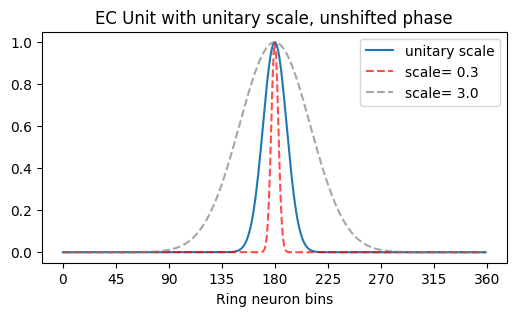

In [168]:
ec_unit = ECModule(K=360, base_width=10.0, scale= 1.0)
ec_smaller = ECModule(K=360, base_width=10.0, scale= 0.3)
ec_larger = ECModule(K=360, base_width=10.0, scale =3.0)

plt.figure(figsize = (6,3))
plt.plot(ec_unit.bump, label='unitary scale')
plt.plot(ec_smaller.bump, '--', color='red', alpha=0.7, label='scale= 0.3')
plt.plot(ec_larger.bump, '--', color='grey', alpha=0.7, label = 'scale= 3.0')

plt.xlabel("Ring neuron bins")
plt.xticks([45*i for i in range(9)])
plt.title("EC Unit with unitary scale, unshifted phase")
plt.legend()

os.makedirs('Fig_PlasticityModel', exist_ok=True)
plt.savefig(f'Fig_PlasticityModel/EC_bumps.png', dpi=300, bbox_inches="tight")
plt.show()

We can also visualize the speed:

In [ ]:
K = 360
a = 10.0
scale1 = 1.0
scale2 = 2.0
module1 = ECModule(K=K, base_width=a, scale=scale1)
module2 = ECModule(K=K, base_width=a, scale=scale2)

fig, ax = plt.subplots(figsize=(6, 4))
line1, = ax.plot([], [], lw=2)
line2, = ax.plot([], [], lw=2)
ax.set_xlim(0, K - 1)
ax.set_ylim(0, 1.1)
ax.set_xlabel("Neuron / phase bin")
ax.set_ylabel("Activity")

T = 400
t_values = np.arange(1, T + 1)

def init():
    line1.set_data([], [])
    line2.set_data([], [])
    return line1, line2,

def update(frame_idx):
    t = t_values[frame_idx]
    x = np.arange(K)
    y1 = module1.activity(t)
    y2 = module2.activity(t)
    line1.set_data(x, y1)
    line2.set_data(x, y2)
    ax.set_title(f"ECModule bump, t = {t}")
    return line1, line2,

ani = FuncAnimation(fig, update, frames=len(t_values),
                    init_func=init, interval=50, blit=True)

HTML(ani.to_jshtml())

## Landmark Unit LM
LM is a single neuron (a scalar unit) that represents a landmark signal. Namely, LMs are landmark-aligned units, so cells whose activity peaks at endogenous landmarks

It is a standalone unit (different from GC unit) which:
- receives an external periodic signal during NTS task (visual phase), when landmarks are visible
- always receives an internal periodic signal from EC/GC modules
- learns to associate grid-cell phases with landmark timings

LM here is a pure **readout**.

It is modeled in the same way as the EC module Gaussian bump so it needs

- a number of neurons arranged in a ring (K)
- for simplicity, we assume it has base scale (will not be scaled later)
- some fixed phase degree is specified, representing the exact moment in a cycle a landmark is shown

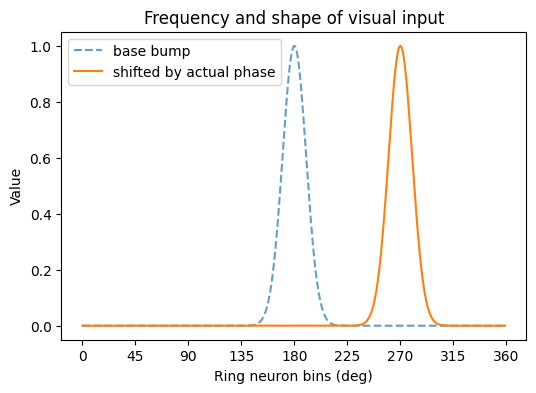

In [169]:
# in this case the shape of the curve plotted is independent of the module index, which will be useful in the actual model of plasticity.

lm_90 = LandmarkUnit(K= 360, base_width = 10, lm_module_index = 0, lm_phases_deg = 90)
plt.figure(figsize = (6,4))
plt.plot(lm_90.base_bump, '--', label='base bump', alpha= 0.7)
plt.plot(lm_90.lm_ext, label='shifted by actual phase')
plt.xlabel('Ring neuron bins (deg)')
plt.ylabel('Value')
plt.xticks([45*i for i in range(9)])
plt.title('Frequency and shape of visual input')
plt.legend()
os.makedirs('Fig_PlasticityModel', exist_ok=True)
plt.savefig(f'Fig_PlasticityModel/LM_curve.png', dpi=300, bbox_inches="tight")
plt.show()

## Plasticity Model

Needs:
- a list of $M$ modules (each with some predetermined $K$ number of neurons and its own frequency (*scale*))
- a landmark defined over $K$ ring neurons, a specified frequency (represented by one of the module indices) and a phase degree
- a learning rate for the Hebbian weights update $\eta$
- a time step where the visual input is no longer shown

Idea to test: **LM unit strengthens connections from GC phases that co-occur with external landmarks**.

In other words, **LM learns GC frequencies and phases matching the external rhythm**

## Algorithm

- **Initialize**
    - Define parameters:
        - parameters $K$ (number of bins in $1D$ ring)
        - $M$ number of modules
        - $T$ number of epochs and $t_\text{off}$ tipe step at which visual stimuli are turned off
        - $\text{base\_scale}$ for the Gaussian bumps
        - sampled *LM\_module*
        - *LM\_phase\_deg*
        - $\eta$: learning rate for Oja's update
    - Initialize the EC modules, each with its *spatial period* controlled by a $\text{scale}$ param
    - Initialize a single LM unit whose frequency is matched by EC module $m^* = $*LM\_module* at phase *LM\_phase\_deg*

    - Initialize weights $W_0 \sim N(0, \sigma^2) \in \mathbb{R}^{K\times M}$


- For $t = 1, \dots T:$

    1. **Compute EC activity**
    - For each module $i$:
        - $t_i = \text{round}(t / \text{scale}[i])$ $\longrightarrow$ set the internal time unit according to the module's scale
        - $\phi_i = (t_i - 1) \mod K$ $\longrightarrow$ compute the module's current phase bin
        - $x_i = \text{circshift}(g_i, \phi_i)$ $\longrightarrow$ shift module $i$'s template bump according to the phase
    
    - compute matrix $X_t = [x_1, ..., x_M] \in \mathbb{R}^{K\times M}$

    2. **Internal LM input**
    - $s_\text{int} = \sum_{i=1}^M W_t[:,i]^T x_i$

    3. **External LM input (only meaningful before t_off)**
    - $\phi_{\text{LM}} = \phi_{m*}(t)$
    - $I_\text{ext} = g_\text{ext}[\phi_{\text{LM}}] \in \mathbb{R}$

    4. **LM activity**
    - if $t < t_\text{off}$ : $\Longrightarrow$ $s = s_\text{int} + I_\text{ext}$
    - if $t \geq t_\text{off}$ : $\Longrightarrow$ $s = s_\text{int}$

    5. **Update weights (Oja)**
    - $W_{t+1} = W_t+ \eta * s * (X_t - s * W_t)$

    6. **Center weights column-wise**
    - For each column (module) $i$:
        - $W_{t+1}[:,i] -= \text{mean}(W_{t+1}[:,i])$

End

In [128]:
K = 360
Nr_modules = 4
a = 10.0
eta = 1e-7

T = 2000000
t_off = 1000000

LM_module = 2
LM_phase_deg = 90.0

- In visual phase: LM fires because external LM pulses + there is some emerging internal GC input

- In mental phase: LM fires even without visual external input, but only if the GC $\rightarrow$ LM synapses have learnt a pattern that rproduces the landmark rhythm

**Weight update**: only weights connecting 'correct' modules to LM are updated, and their weights is strengthened even after mental phase starts.

so, in the presence of external landmarks (NTS), synapses are modified such that CAN inputs mimicked the external input (so **endogenous landmarks are created**), and when the external landmark was turned off (MNAV), the CAN drive alone was able to emulate that external drive $\rightarrow$ LM firing takes place anyway.

so, we now test the idea that matching dynamics allow CAN units to reproduce LM activity during MNAV, when landmarks are invisible.

in this example, we hardcode that the landmark has scale 1 and base frequency (so it is matched by module 1, which has scale 1 too).

In [170]:
## generate modules
modules = []
mod_sc = {}
for i in range(Nr_modules):
    exponent = (i + 1) - Nr_modules / 2.0   # i+1 per matchare i=1..Nmodule
    scale_i = 1.1**exponent
    mod_sc[f'{i}'] = scale_i
    modules.append(ECModule(K= K, base_width = a, scale = scale_i))

print(f'modules and scales: {mod_sc}')

modules and scales: {'0': 0.9090909090909091, '1': 1.0, '2': 1.1, '3': 1.2100000000000002}


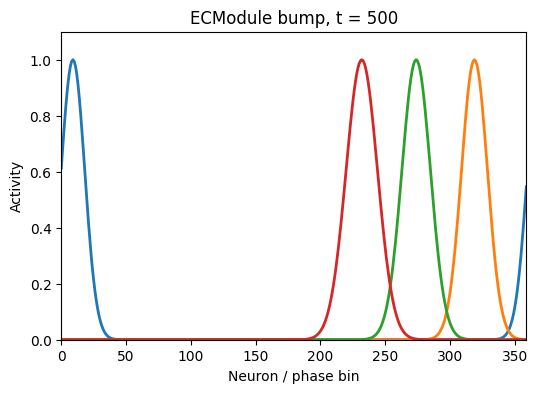

In [180]:
fig, ax = plt.subplots(figsize=(6, 4))
line1, = ax.plot([], [], lw=2)
line2, = ax.plot([], [], lw=2)
line3, = ax.plot([], [], lw=2)
line4, = ax.plot([], [], lw=2)
ax.set_xlim(0, K - 1)
ax.set_ylim(0, 1.1)
ax.set_xlabel("Neuron / phase bin")
ax.set_ylabel("Activity")

T = 500
t_values = np.arange(1, T + 1)

def init():
    line1.set_data([], [])
    line2.set_data([], [])
    line3.set_data([], [])
    line4.set_data([], [])
    return line1, line2, line3, line4,

def update(frame_idx):
    t = t_values[frame_idx]
    x = np.arange(K)
    y1 = modules[0].activity(t)
    y2 = modules[1].activity(t)
    y3 = modules[2].activity(t)
    y4 = modules[3].activity(t)
    line1.set_data(x, y1)
    line2.set_data(x, y2)
    line3.set_data(x, y3)
    line4.set_data(x, y4)
    ax.set_title(f"ECModule bump, t = {t}")
    return line1, line2, line3, line4

ani = FuncAnimation(fig, update, frames=len(t_values),
                    init_func=init, interval=50, blit=True)

gif_path = "Fig_PlasticityModel/EC_mods_animation.gif"
ani.save(gif_path, writer=PillowWriter(fps=20))
HTML(ani.to_jshtml())


In [115]:
landmark_unit = LandmarkUnit(
    K=K,
    base_width = a,
    lm_phases_deg = LM_phase_deg,
    lm_module_index = LM_module)

now we execute the model and store the history weights.

remark: In this toy model, there is no distinction between some learning and inference phase, in the sense that weights always adapt since plasticity is always on, so both in the 'visual' and 'mental' phase with ext LM on and off.

- Before $t < t_\text{off}$, LM learns to align with the external landmark pattern, since weights are updated depending on s_int and s_ext

- After $t > t_\text{off}$, LM continues to adapt, now only driven by internally generated landmark-like signals (so lile consolidation, refinement in their story)

In [129]:
model = LMGCPlasticityModel(
    list_modules = modules,
    landmark = landmark_unit,
    eta = eta,
    t_off = t_off,
    seed = 42)

model.run(T=T, snapshot_interval = 500, store_hist=True)

In [130]:
W_init = model.get_initial_weights()
W_final = model.get_final_weights()
hist = model.get_history()

In [31]:
print("||W_final - W_init||_F:",
      np.linalg.norm(W_final - W_init),
      "  ||W_init||_F:", np.linalg.norm(W_init))

||W_final - W_init||_F: 0.021616424735199997   ||W_init||_F: 0.02603065315184513


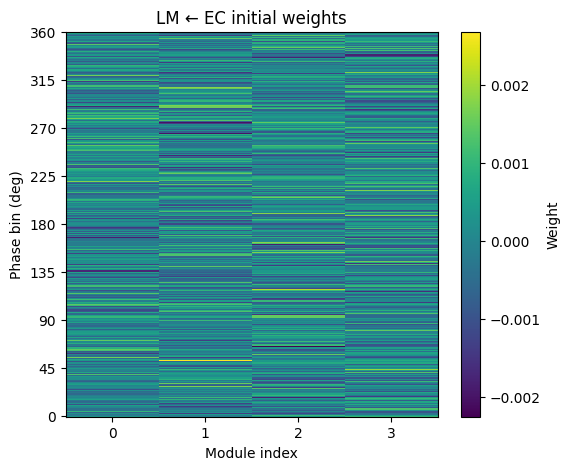

In [172]:
plt.figure(figsize=(6, 5))
plt.imshow(W_init, aspect="auto", origin="lower", interpolation='nearest')
plt.colorbar(label="Weight")
plt.xlabel("Module index")
plt.ylabel("Phase bin (deg)")
plt.xticks([i for i in range(Nr_modules)])
plt.yticks([45*x for x in range(9)])
row_idx = LM_phase_deg
#plt.plot([LM_module], [row_idx], "ko", markersize=6)
plt.title("LM ← EC initial weights")

os.makedirs('Fig_PlasticityModel', exist_ok=True)
plt.savefig(f'Fig_PlasticityModel/W_init.png', dpi=300, bbox_inches="tight")
plt.show()

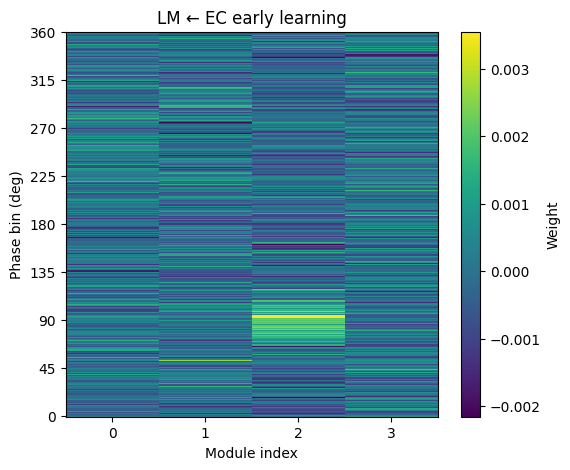

In [173]:
plt.figure(figsize=(6, 5))
plt.imshow(hist['weights'][900], aspect="auto", origin="lower", interpolation="nearest")
plt.colorbar(label="Weight")
plt.xlabel("Module index")
plt.ylabel("Phase bin (deg)")
plt.xticks([i for i in range(Nr_modules)])
plt.yticks([45*x for x in range(9)])
row_idx = LM_phase_deg
#plt.plot([LM_module], [row_idx], "ko", markersize=6)
plt.title("LM ← EC early learning")
os.makedirs('Fig_PlasticityModel', exist_ok=True)
plt.savefig(f'Fig_PlasticityModel/W_early.png', dpi=300, bbox_inches="tight")
plt.show()

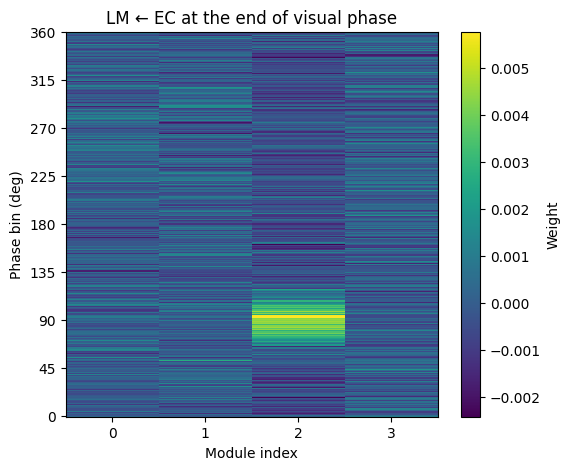

In [174]:
plt.figure(figsize=(6, 5))
plt.imshow(hist['weights'][1800], aspect="auto", origin="lower", interpolation="nearest")
plt.colorbar(label="Weight")
plt.xlabel("Module index")
plt.ylabel("Phase bin (deg)")
plt.xticks([i for i in range(Nr_modules)])
plt.yticks([45*x for x in range(9)])
row_idx = LM_phase_deg
#plt.plot([LM_module], [row_idx], "ko", markersize=6)
plt.title("LM ← EC at the end of visual phase")
os.makedirs('Fig_PlasticityModel', exist_ok=True)
plt.savefig(f'Fig_PlasticityModel/W_endvis.png', dpi=300, bbox_inches="tight")
plt.show()

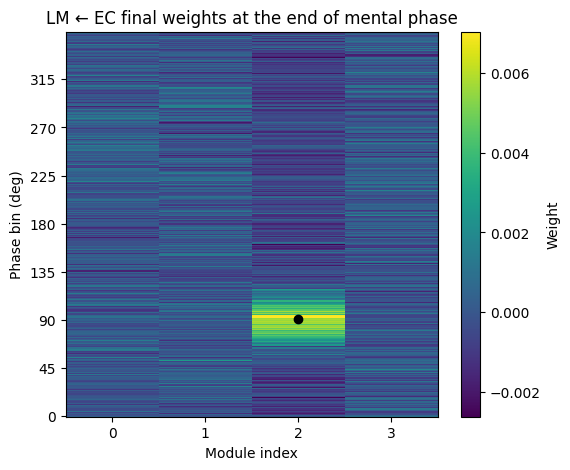

In [175]:
plt.figure(figsize=(6, 5))
plt.imshow(W_final, aspect="auto", origin="lower", interpolation="nearest")
plt.colorbar(label="Weight")
plt.xlabel("Module index")
plt.ylabel("Phase bin (deg)")
plt.xticks(range(Nr_modules))
plt.yticks([45*x for x in range(9)])
row_idx = LM_phase_deg
plt.plot([LM_module], [row_idx + 0.5], "ko")
plt.title("LM ← EC final weights at the end of mental phase")
os.makedirs('Fig_PlasticityModel', exist_ok=True)
plt.savefig(f'Fig_PlasticityModel/W_final.png', dpi=300, bbox_inches="tight")
plt.show()

## Visualizing evolution of the activity in time

In [148]:
hist.keys()

dict_keys(['time_step', 'weights', 'NTS_flg', 'total_activity', 'int_input', 'ext_input'])

In [162]:
pd.Series(hist['NTS_flg']).value_counts()

0    2001
1    1999
Name: count, dtype: int64

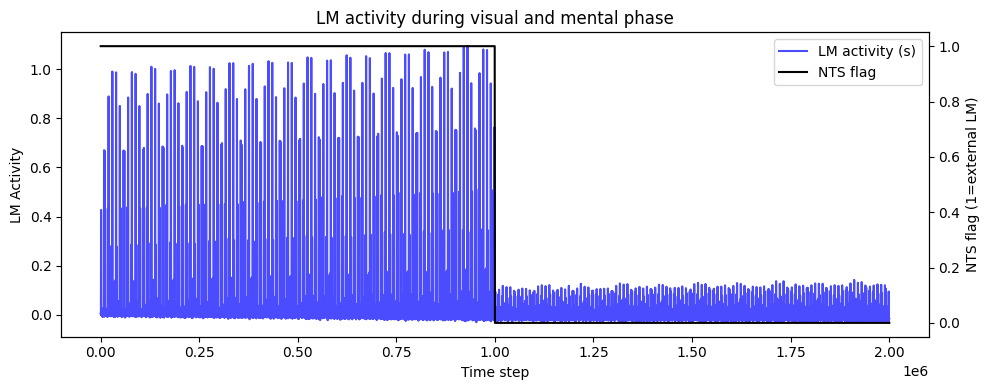

In [176]:
s = np.array(hist['total_activity'])   # LM activity
s_int = np.array(hist['int_input'])
s_ext = np.array(hist['ext_input'])
nts = np.array(hist['NTS_flg'])        # 1 = external LM ON, 0 = OFF
times = np.array(hist['time_step'])

fig, ax1 = plt.subplots(figsize=(10, 4))

# --- Asse principale: attività LM ---
ax1.plot(times, s, color='blue', label='LM activity (s)', alpha=0.7)
#ax1.plot(times, s_int, color='green', alpha=0.4, label='internal input (s_int)')
#ax1.plot(times, s_ext, color='red', alpha=0.4, label='external input (s_ext)')

ax1.set_xlabel("Time step")
ax1.set_ylabel("LM Activity")
ax1.set_title("LM activity during visual and mental phase")


ax2 = ax1.twinx()
ax2.plot(times, nts, color='black', label='NTS flag')
ax2.set_ylabel("NTS flag (1=external LM)")


lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, loc="upper right")

plt.tight_layout()
os.makedirs('Fig_PlasticityModel', exist_ok=True)
plt.savefig(f'Fig_PlasticityModel/LM_activity.png', dpi=300, bbox_inches="tight")
plt.show()

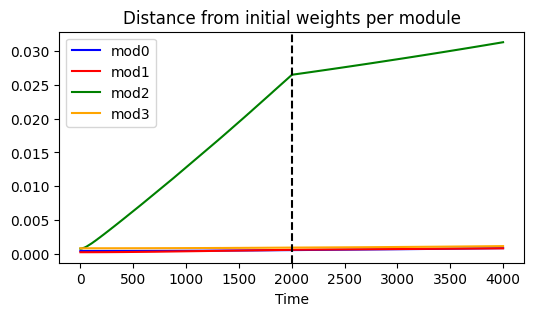

In [177]:
weights_dist = {f'{i}':[] for i in range(Nr_modules)}
for t in range(len(hist['time_step'])):
    for i in range(Nr_modules):
        weights_dist[f'{i}'].append(np.linalg.norm(hist['weights'][t, :, i] - W_init[:, i]))

plt.figure(figsize = (6,3))
plt.plot(weights_dist['0'], color='blue', label='mod0')
plt.plot(weights_dist['1'], color='red', label='mod1')
plt.plot(weights_dist['2'], color='green', label='mod2')
plt.plot(weights_dist['3'], color='orange', label='mod3')
plt.axvline(x = t_off / 500, linestyle='--', color= 'black')
plt.xlabel("Time")
plt.title("Distance from initial weights per module")
plt.legend()
os.makedirs('Fig_PlasticityModel', exist_ok=True)
plt.savefig(f'Fig_PlasticityModel/Weights_evol.png', dpi=300, bbox_inches="tight")
plt.show()

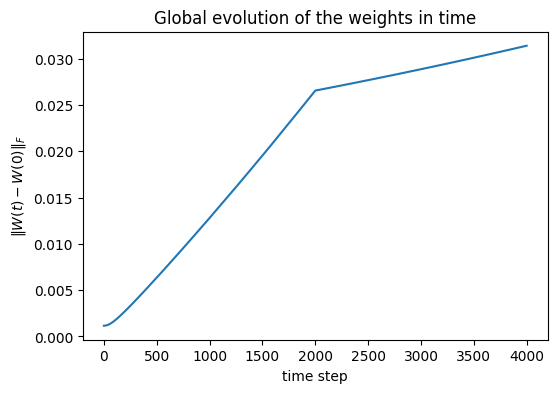

In [147]:
dist_global = [
    np.linalg.norm(W_t - W_init)   # Frobenius norm
    for W_t in hist['weights']
]

plt.figure(figsize=(6, 4))
plt.plot(dist_global)
plt.xlabel("time step")
plt.ylabel(r"$\|W(t) - W(0)\|_F$")
plt.title("Global evolution of the weights in time")
plt.show()